# Data Airbnb

El objetivo de este trabajo es mostrar distintos tipos de modelizaciones y análisis con el dataset provisto de Airbnb (http://insideairbnb.com/get-the-data/ dataset de Madrid). Se aportan distintas visualizaciones y explicaciones a los efectos de sacar insights y oportunidades para trabajar con estos datos. Sin duda, en cada tema que aquí se menciona hay una gran oportunidad para profundizar. Trate de balancear el nivel de profundidad y largo del trabajo buscando un óptimo entre ser conciso sin perder rigurosidad técnica.

### Variable precio
#### Análisis descritptivo

In [1]:
import streamlit as st
import pandas as pd
import matplotlib as plt
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
#import geojson
import folium
from streamlit_folium import st_folium

from pandas.plotting import autocorrelation_plot
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf #,plot_predict
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
#from statsmodels.graphics.tsaplots import plot_predict
from statsmodels.tsa.seasonal import seasonal_decompose
#from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.stats.diagnostic import het_arch

import wordcloud
wordcloud = wordcloud.WordCloud()

from wordcloud import WordCloud



import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 65)

listings = pd.read_csv('dataset_nuevo/listings.csv')
listings_completo = pd.read_csv('dataset_nuevo/listings.csv.gz',compression='gzip',low_memory=False)

c:\Users\franc\Envs\keepler1\lib\site-packages\geopandas\_compat.py:112: UserWarning: The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [3]:
# Armo un df que cuenta la cantidad de nulos para cada variable
nulos = pd.DataFrame(listings_completo.isnull().sum().sort_values(ascending=False),columns=['q_nulos'])
#  Me quedo con las variables que tienen al menos el 70% de los datos no nulos
nulos['q_porc'] = (nulos['q_nulos'] / len(listings_completo))*100
variables = nulos[nulos['q_porc'] <= 30]
listings_variables = listings_completo[variables.index.to_list()]

# Me agrego una columna de 1 para que sean más cómodos los groupby
listings_variables['q'] = 1

# Arreglo la variable Precio
listings_variables["price"] = listings_variables["price"].str.replace("$", "" ,regex=True)
listings_variables["price"] = listings_variables["price"].str.replace("(.{3}$)", "" ,regex=True)
listings_variables["price"] = listings_variables["price"].str.replace(",", "" ,regex=True)
listings_variables["price"] = pd.to_numeric(listings_variables["price"])

Tenemos 21495 publicaciones con distintos datos. Vamos a analizar cómo se comporta el precio de las publicaciones. Para ello primero sacamos un descriptivo básico de esta variable y graficamos un histograma para ver cómo es su distribución.

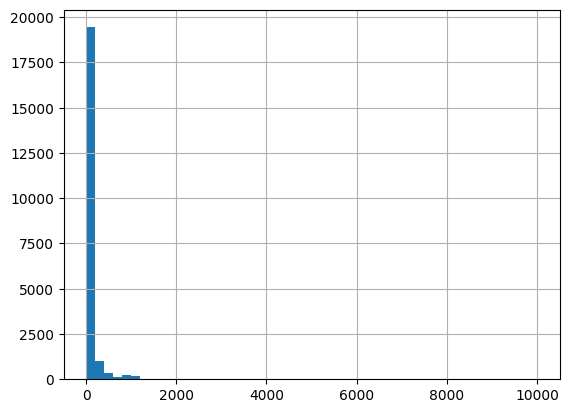

In [4]:
listings_variables['price'].hist(bins=50)
plt.show()

In [5]:
listings_variables['price'].describe()

count    21495.000000
mean       130.507141
std        361.336857
min          1.000000
25%         40.000000
50%         65.000000
75%        101.000000
max       9999.000000
Name: price, dtype: float64

Claramente vemos que existen potenciales <i>outliers</i>. Si bien esta afirmación puede ser un poco fuerte dado que no definimos qué es un <i>outliers</i> (¿es un valor que no pertenece a la distribución?, ¿es un valor con bajísima probabilidad de ocurrencia? etc) vamos a ajustarnos a nuestra necesidad: entender la variable precio. Esta variable surge cuando el dueño de la propiedad pone libremente el precio que quiere cobrar. Se ve que hay publicadores que prefieren poner un valor de 1 o de 9999. Probablemente sean personas que quieran negociar o algo por el estilo. Sea como fuere, no nos aporta información para ver cómo se comporta esta variable. Para poder entender la variable <i>podar</i> las colas de la distribución. En primera instancia eliminamos el 2,5% superior e inferior y vemos como queda la distribución.

In [6]:
q_low = listings_variables["price"].quantile(0.025)
q_hi  = listings_variables["price"].quantile(0.975)
listings_variables = listings_variables[(listings_variables["price"] < q_hi) & (listings_variables["price"] > q_low)]

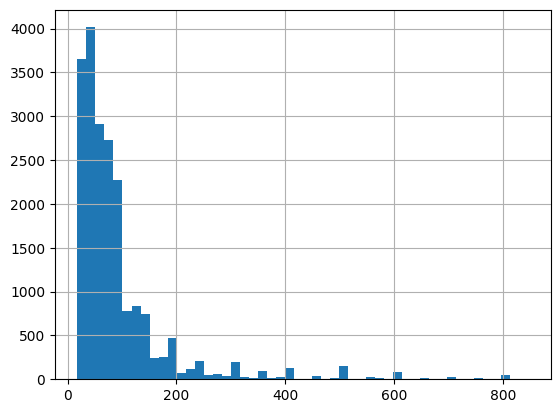

In [7]:
listings_variables['price'].hist(bins=50)
plt.show()

In [8]:
listings_variables['price'].describe()

count    20411.000000
mean        93.502768
std        100.497828
min         18.000000
25%         40.000000
50%         65.000000
75%        100.000000
max        847.000000
Name: price, dtype: float64

Vamos a adentrarnos un poco más en el dataset. Tenemos 106 columnas, una corresponde al precio y otra al <i>id</i> de la publicación, por ende 104 potenciales variables. El dataset tiene varios valores nulos. El surgimiento de estos valores se puede deber a varios factores. Hay literatura respecto al tema que plantea tres potenciales fuentes de valores nulos: Missing Completely at Random (MCAR),  Missing at Random (MAR) y Missing Not at Random (MNAR). En nuestro caso, en principio nos quedamos con las columnas que tienen al menos el 70% de los datos. Con esto bajamos la cantidad de potenciales variables a 87.

In [9]:
# Teniamos 106 columnas, una pertenece al id de la publicación y otra al precio, por ende 104 potenciales variables. Nos quedamos con las columnas que tienen al menos
# el 70% de los datos y bajamos a 87 potenciales variables (90 - id - price - q). Por otro lado la variable precio tenia valores que no nos iban a aportar nada (9999 o 1).
# Por lo que limpie outliers de 21495 observaciones pase a tener 20411
listings_variables.shape , listings_completo.shape

((20411, 90), (21495, 106))

In [10]:
#observaciones , variables
(20411 / 21495)*100 , (87 / 104)*100

(94.95696673645033, 83.65384615384616)

#### Análisis GeoEspacial

In [11]:
# Le traigo al dataset los datos de precio promedios
neighbourhood_mean = round(listings_variables.groupby(['neighbourhood_group_cleansed','neighbourhood_cleansed']).agg(precio_prom_neighbourhood = ('price','mean')).reset_index(),2)
neighbourhood_group_mean = round(listings_variables.groupby(['neighbourhood_group_cleansed']).agg(precio_prom_neighbourhood_group = ('price','mean')).reset_index(),2)
listings_variables = listings_variables.merge(neighbourhood_mean,on=['neighbourhood_group_cleansed','neighbourhood_cleansed'],how='left')
listings_variables = listings_variables.merge(neighbourhood_group_mean,on=['neighbourhood_group_cleansed'],how='left')

# Convierto los datos a geo espaciales
geo_listings = gpd.GeoDataFrame(listings, geometry=gpd.points_from_xy(listings.longitude, listings.latitude))
geo_barrios = gpd.read_file('dataset_nuevo/neighbourhoods.geojson')

# Al dataset de barrios y zonas le traigo los precios promedio
geo_listings = geo_listings.merge(neighbourhood_mean,left_on=['neighbourhood_group','neighbourhood'] , right_on=['neighbourhood_group_cleansed','neighbourhood_cleansed'],how='left')
geo_listings = geo_listings.merge(neighbourhood_group_mean,left_on=['neighbourhood_group_cleansed'] , right_on=['neighbourhood_group_cleansed'],how='left')

geo_barrios = geo_barrios.merge(neighbourhood_mean,how='left',left_on=['neighbourhood_group','neighbourhood'],right_on=['neighbourhood_group_cleansed','neighbourhood_cleansed'] )
geo_barrios = geo_barrios.merge(neighbourhood_group_mean,how='left',left_on=['neighbourhood_group_cleansed'],right_on=['neighbourhood_group_cleansed'])

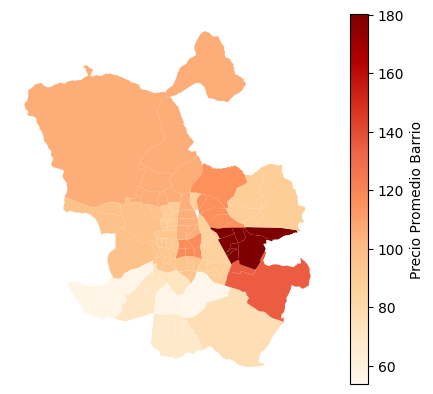

In [12]:
ax = geo_barrios.plot(column='precio_prom_neighbourhood_group',legend=True,cmap='OrRd',legend_kwds={'label': "Precio Promedio Barrio"})
ax.set_axis_off();

Miremos con mayor detalle los precios promedio de cada barrio y la cantidad de publicaciones que tiene cada uno. El Centro se lleva casi el 50% de las publicaciones y un precio promedio poco menor a 100 euros.

In [13]:
agrup1 = listings_variables.groupby(['neighbourhood_group_cleansed']).agg(precio_prom = ('price','mean'),q_publicaciones = ('q','sum'))#.reset_index()
agrup1['porc_publi'] = round((agrup1['q_publicaciones'] / agrup1['q_publicaciones'].sum())*100,2)
agrup1['precio_prom'] = round(agrup1['precio_prom'],2)
agrup1 = agrup1[['precio_prom','porc_publi']]
agrup1.columns = ['Precio Promedio','% Q Publicaciones']
agrup1.index.names = ['Zona']
agrup1.sort_values(by=['% Q Publicaciones'],ascending=False,inplace=True)
agrup1

,Precio Promedio,% Q Publicaciones
Zona,,
Centro,94.32,47.90
Salamanca,117.89,6.57
Chamberí,93.44,6.04
Arganzuela,73.00,5.53
Tetuán,90.46,4.04
Retiro,95.56,3.16
Carabanchel,71.15,3.10
Ciudad Lineal,87.09,2.90
Puente de Vallecas,53.72,2.84


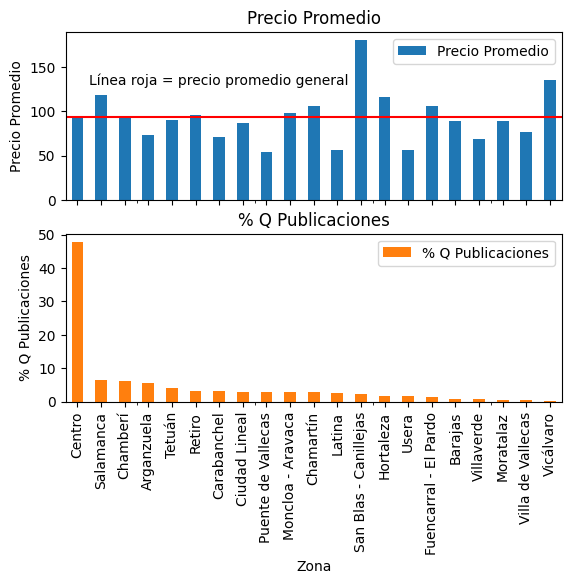

In [14]:

axes = agrup1.plot.bar(subplots=True)
axes[0].axhline(agrup1['Precio Promedio'].mean(),color='red') 
axes[0].text(x=0.5,y=130,s='Línea roja = precio promedio general') 
axes[0].set_ylabel('Precio Promedio')  
axes[1].set_ylabel('% Q Publicaciones')  
plt.xticks(rotation=90)
plt.show()

Al estar casi la mitad de las publicaciones están concentradas en el área Centro vale la pena hacer un poco de zoom en sus Barrios. Embajadores es el barrio con más publicaciones y precio promedio más bajo dentro del área. A medida que hay menos publicaciones el precio promedio va subiendo, dando a entender que cualquier Barrio del área Centro es deseado y a medida que baja la oferta, sube el precio.</div>

In [15]:
agrup2 = listings_variables[listings_variables['neighbourhood_group_cleansed'] == 'Centro'].groupby(['neighbourhood_cleansed']).agg(precio_prom = ('price','mean'),q_publicaciones = ('q','sum'))#.reset_index()
agrup2['porc_publi'] = round((agrup2['q_publicaciones'] / agrup2['q_publicaciones'].sum())*100,2)
agrup2['precio_prom'] = round(agrup2['precio_prom'],2)
agrup2 = agrup2[['precio_prom','porc_publi']]
agrup2.columns = ['Precio Promedio área Centro','% Q Publicaciones dentro de área Centro']
agrup2.index.names = ['Barrio del Centro']
agrup2.sort_values(by=['% Q Publicaciones dentro de área Centro'],ascending=False,inplace=True)
agrup2

,Precio Promedio área Centro,% Q Publicaciones dentro de área Centro
Barrio del Centro,,
Embajadores,79.68,27.82
Universidad,93.73,20.46
Palacio,101.07,15.64
Sol,103.31,13.95
Justicia,103.86,11.99
Cortes,101.67,10.15


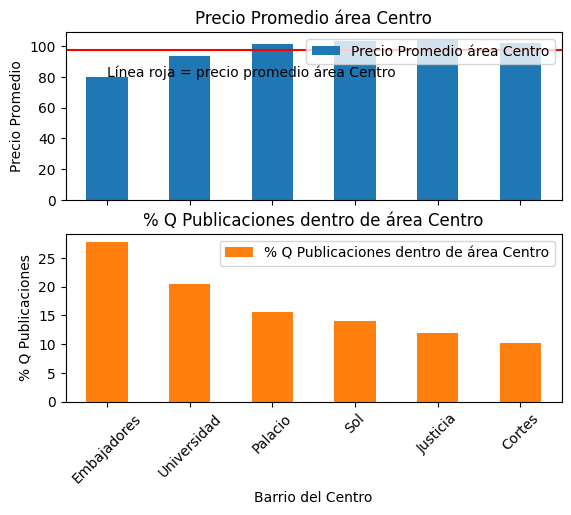

In [16]:
axes = agrup2.plot.bar(subplots=True)
axes[0].axhline(agrup2['Precio Promedio área Centro'].mean(),color='red') 
axes[0].text(x=0,y=80,s='Línea roja = precio promedio área Centro') 
axes[0].legend(loc=1)
axes[0].set_ylabel('Precio Promedio')  
axes[1].set_ylabel('% Q Publicaciones')  
plt.xticks(rotation=45)
plt.show()

Para concluir el análisis geoespacial se presenta un mapa interactivo con todas las publicaciones y las áreas con sus precio promedio (calculado sin <i>outliers</i>), al posicionarse sobre un área muestra los datos del área, y al posicionarse sobre una publicación muestra info básica de la publicación de la zona.

In [17]:
listing_url = listings_completo[['id','listing_url']]
geo_listings = geo_listings.merge(listing_url,how='left',on=['id'])

mapa = geo_barrios.explore(
     column="precio_prom_neighbourhood_group",  # make choropleth based on "BoroName" column
     scheme="naturalbreaks",  # use mapclassify's natural breaks scheme
     legend=True, # show legend
     k=10, # use 10 bins
     legend_kwds=dict(colorbar=False), 
     name="Precios Barrios" 
)

geo_listings.explore(
     m=mapa, # pass the map object
     color="red", 
     marker_kwds=dict(radius=1, fill=True), 
     tooltip=['id','listing_url','host_id', 'host_name', 'room_type','neighbourhood_group','neighbourhood','price','precio_prom_neighbourhood','precio_prom_neighbourhood_group'],
     tooltip_kwds=dict(labels=True), # do not show column label in the tooltip
     name="Publicaciones" 
)

folium.TileLayer('Stamen Toner', control=True).add_to(mapa)  # use folium to add alternative tiles
folium.LayerControl().add_to(mapa)  # use folium to add layer control

mapa  

Antes de pasar a la siguiente sección abramos el análisis, además de por zona, por tipo de alojamiento. El alojamiento completo (Entire home/apt) es el segundo más caro y el que más publicaciones tiene con casi el 65%, lo sigue la habitación privada, que es el tipo de alojamiento más barato. Los tipos de alojamiento restantes tienen una cantidad de publicaciones prácticamente marginales.

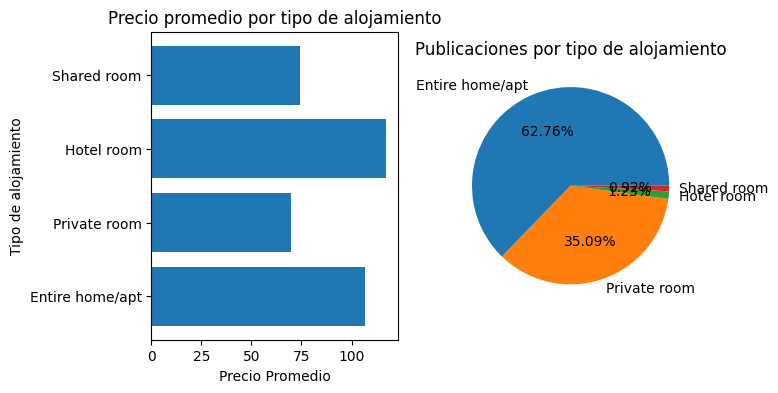

In [18]:
agrup3 = listings_variables.groupby(['room_type']).agg(precio_prom = ('price','mean'),q_publicaciones = ('q','sum'))#.reset_index()
agrup3['porc_publi'] = round((agrup3['q_publicaciones'] / agrup3['q_publicaciones'].sum())*100,2)
agrup3['precio_prom'] = round(agrup3['precio_prom'],2)
agrup3 = agrup3[['precio_prom','porc_publi']]
agrup3.columns = ['Precio Promedio','% Q Publicaciones']
agrup3.index.names = ['Room Type']
agrup3.sort_values(by=['% Q Publicaciones'],ascending=False,inplace=True)

fig , axes = plt.subplots(1,2)
fig.set_size_inches([7,4])

axes[0].barh(agrup3.index,agrup3['Precio Promedio'])
axes[0].set_title('Precio promedio por tipo de alojamiento')
axes[0].set_xlabel('Precio Promedio')
axes[0].set_ylabel('Tipo de alojamiento')

axes[1].pie(agrup3['% Q Publicaciones'],autopct='%1.2f%%',labels=agrup3.index)
axes[1].set_title("Publicaciones por tipo de alojamiento")

plt.show()

Miremos con mayor detalle las medidas resumen de las áreas y los Tipo de Alojamiento. Vale recordar a esta altura que realizamos una poda de los datos donde quitamos el 5% de los datos en base a los precios (2.5% correspondiente a los valores más bajos e igual porcentaje para los valores más altos). El <i>boxplot</i> de los precios por Área y Tipo de Alojamiento se vuelve difícil sacar conclusiones, todavía tenemos muchos valores atípicos o que el <i>boxplot</i> los interpreta como <i>outliers</i>.

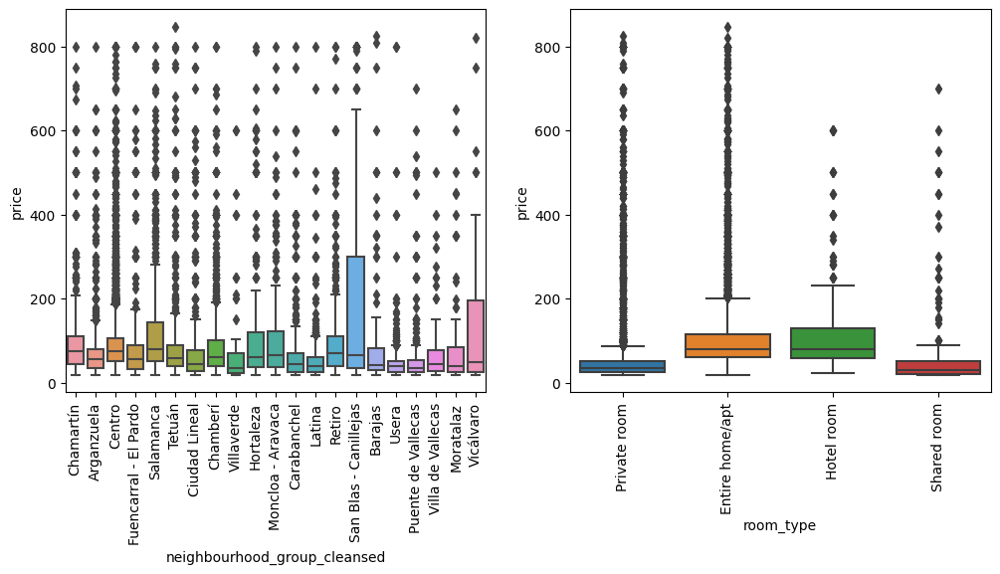

In [19]:
agrup4 = listings_variables[['neighbourhood_group_cleansed','room_type','price']]

#sns.set()
f, axes = plt.subplots(1, 2,figsize=(12,5))
ax1 = sns.boxplot(data=agrup4, x='neighbourhood_group_cleansed', y='price',ax=axes[0])
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=90)
ax2 = sns.boxplot(data=agrup4, x='room_type', y='price',ax=axes[1])
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=90)
plt.show()

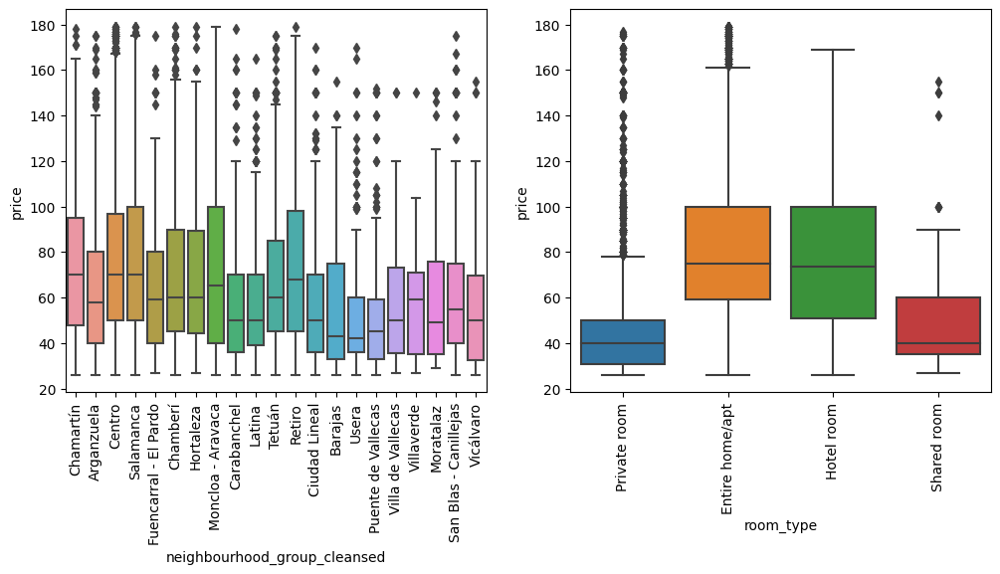

In [20]:
q_low = agrup4["price"].quantile(0.10)
q_hi  = agrup4["price"].quantile(0.90)
agrup5 = agrup4[(agrup4["price"] < q_hi) & (agrup4["price"] > q_low)]

f, axes = plt.subplots(1, 2,figsize=(12,5))
ax1 = sns.boxplot(data=agrup5, x='neighbourhood_group_cleansed', y='price',ax=axes[0])
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=90)
ax2 = sns.boxplot(data=agrup5, x='room_type', y='price',ax=axes[1])
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=90)
plt.show()

Para ganar interpretabilidad en los <i>boxplots</i> vamos a hacer una nueva poda: a los datos (ya podados) le sacamos el 10% superior e inferior. Esto nos deja el 75% de los datos del total. Perdimos una buena cantidad de datos pero ganamos un poco de interpretación. Es lógico que quien publica busque el precio más alto posible, eso se ve reflejado en los <i>outliers</i> fuera del bigote superior y en la extensión de este bigote. De alguna manera, con este gráfico podemos asesorar a un cliente para que publique un precio alto pero "lógico" en función del área y tipo de alojamiento. Debajo se muestra como queda en números descriptivos los valores de precio luego de la poda general más grande y la distribución de la variable.

In [21]:
len(agrup5) / len(listings_completo)

0.7571063037915794

In [22]:
len(listings_variables) / len(listings_completo)

0.9495696673645033

In [23]:
agrup4['price'].describe()

count    20411.000000
mean        93.502768
std        100.497828
min         18.000000
25%         40.000000
50%         65.000000
75%        100.000000
max        847.000000
Name: price, dtype: float64

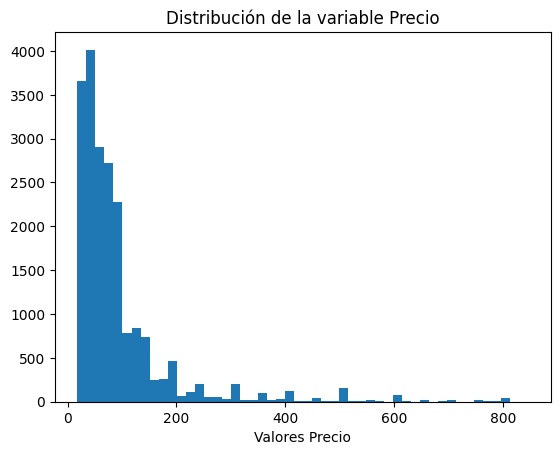

In [24]:
fig5 = plt.figure() 
plt.hist(agrup4['price'],bins=50)
plt.xlabel('Valores Precio')
plt.title('Distribución de la variable Precio')
plt.show()

#### Análisis serie temporal

Veamos un poco como se comporta la variable precio a lo largo del tiempo. En un contexto donde se comienza a hablar de inflación, este tipo de análisis se vuelve muy relevante. El análisis presentado se realiza en el marco teórico de los modelos Autorregresivos de Media Móvil, popularmente conocidos como ARMA (p,q) y sus derivados (AMRMAX, ARIMA, etc). Las series temporales en general tienen una tendencia, un componente estacional y un componente cíclico. Primero se calcula el precio promedio por fecha de publicación. El periodo que tenemos es aproximadamente un año, para poder realizar el análisis en el marco teórico planteado y al observar el gráfico a continuación, queda claro que tenemos que extraer la tendencia y el componente estacional. El objetivo es obtener una serie estacionaria en media desestacionalizada para aplicar lo que se conoce como la metodología Box–Jenkins.

In [25]:
calendar = pd.read_csv('dataset_nuevo/calendar.csv.gz')
calendar['date'] = pd.to_datetime(calendar['date'])
# Arreglo la variable Precio
calendar["price"] = calendar["price"].str.replace("$", "" ,regex=True)
calendar["price"] = calendar["price"].str.replace("(.{3}$)", "" ,regex=True)
calendar["price"] = calendar["price"].str.replace(",", "" ,regex=True)
calendar["price"] = pd.to_numeric(calendar["price"])

# Arreglo la variable Precio
calendar["adjusted_price"] = calendar["adjusted_price"].str.replace("$", "" ,regex=True)
calendar["adjusted_price"] = calendar["adjusted_price"].str.replace("(.{3}$)", "" ,regex=True)
calendar["adjusted_price"] = calendar["adjusted_price"].str.replace(",", "" ,regex=True)
calendar["adjusted_price"] = pd.to_numeric(calendar["adjusted_price"])

calendar['q'] = 1

calendar = calendar.merge(listings[['id','room_type','neighbourhood_group']],how='left',left_on='listing_id',right_on='id')

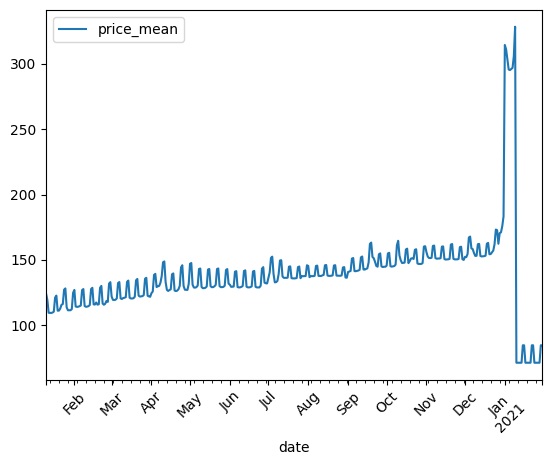

In [26]:
calendar_group_date = calendar.groupby(['date']).agg(price_mean = ('price','mean'),q_x_dia=('q','sum'))
calendar_group_date[['price_mean']].plot()
plt.xticks(rotation=45)
plt.show()

Antes de proceder y, al observar las variables de nuestro dataset, encuentro algunas cosas que me hacen sospechar que puedan afectar a la serie. Es importante cuando se utilizan series temporales tener presente las distintas fuentes de variabilidad que afectan a la serie. En un mundo ideal, la serie luego de desestacionalizada y diferenciada, tiene una varianza aleatoria y constante, aunque no siempre se consigue eso. La variable <i>available</i> es una booleana que indica si el alojamiento está disponible o no al momento de publicación. Sospecho que esto puede afectar a la variabilidad del precio, pero para comprobarlo grafico por separado.

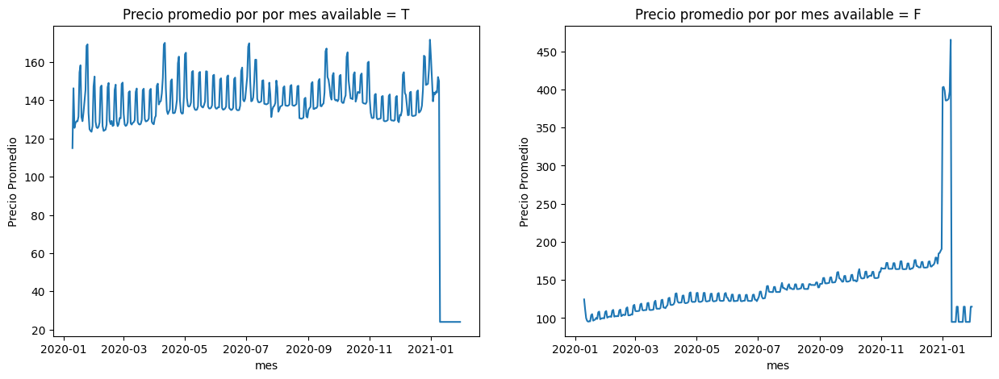

In [27]:
calendar_group_date_t = calendar[calendar['available'] == 't'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_f = calendar[calendar['available'] == 'f'].groupby(['date']).agg(price_mean = ('price','mean'))

fig , axes = plt.subplots(1,2)
fig.set_size_inches([15,5])

axes[0].plot(calendar_group_date_t)
axes[0].set_title('Precio promedio por por mes available = T')
axes[0].set_xlabel('mes')
axes[0].set_ylabel('Precio Promedio')

axes[1].plot(calendar_group_date_f)
axes[1].set_title('Precio promedio por por mes available = F')
axes[1].set_xlabel('mes')
axes[1].set_ylabel('Precio Promedio')

plt.show()

De manera adicional, el Tipo de Alojamiento seguro es otra fuente de variabilidad para nuestra serie.

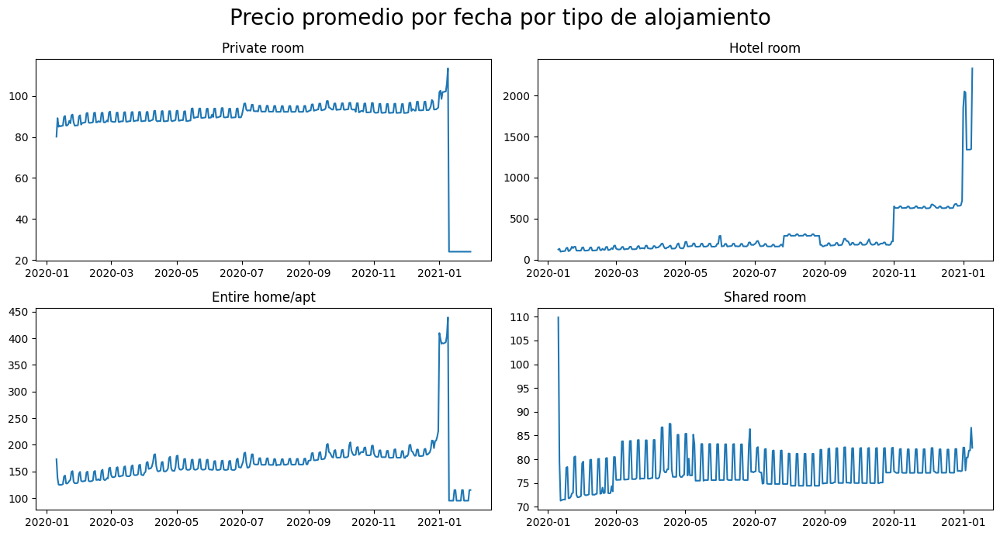

In [28]:
calendar_group_date_pr = calendar[calendar['room_type'] == 'Private room'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_er = calendar[calendar['room_type'] == 'Entire home/apt'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_hr = calendar[calendar['room_type'] == 'Hotel room'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_sr = calendar[calendar['room_type'] == 'Shared room'].groupby(['date']).agg(price_mean = ('price','mean'))

fig , axes = plt.subplots(2,2)
fig.set_size_inches([13,7])

axes[0,0].plot(calendar_group_date_pr)
axes[0,0].set_title('Private room')
axes[0,1].plot(calendar_group_date_hr)
axes[0,1].set_title('Hotel room')
axes[1,0].plot(calendar_group_date_er)
axes[1,0].set_title('Entire home/apt')
axes[1,1].plot(calendar_group_date_sr)
axes[1,1].set_title('Shared room')

plt.suptitle('Precio promedio por fecha por tipo de alojamiento',fontsize=20)
plt.tight_layout()
plt.show()

Agrupamos un poco más, vemos los promedios mensuales en vez de los promedios por fecha de publicación.

In [29]:
room_type = pd.DataFrame(calendar['room_type'].value_counts())
room_type['% Q'] = round(room_type['room_type'] / room_type['room_type'].sum(),2)*100
calendar['yyy_mm'] = calendar['date'].astype(str).str[:7]
agrup_mes_type_room = calendar.groupby(['yyy_mm','room_type']).agg(precio_prom = ('price','mean')).reset_index()
agrup_mes_type_room = pd.pivot_table(agrup_mes_type_room, values='precio_prom',index='yyy_mm',columns='room_type' )
agrup_mes_type_room

room_type,Entire home/apt,Hotel room,Private room,Shared room
yyy_mm,,,,
2020-01,132.807452,121.784655,87.055693,74.339051
2020-02,138.994049,128.443138,88.612959,75.103883
2020-03,146.459016,138.090365,88.810032,77.904549
2020-04,158.770562,153.726932,89.164358,79.133859
2020-05,160.387050,176.600192,90.284349,78.513789
2020-06,158.239129,177.641280,90.832201,77.916193
2020-07,167.218742,194.131916,93.473153,77.298667
2020-08,165.814312,279.048173,93.150985,76.458634
2020-09,178.986453,192.320751,94.222542,76.966982


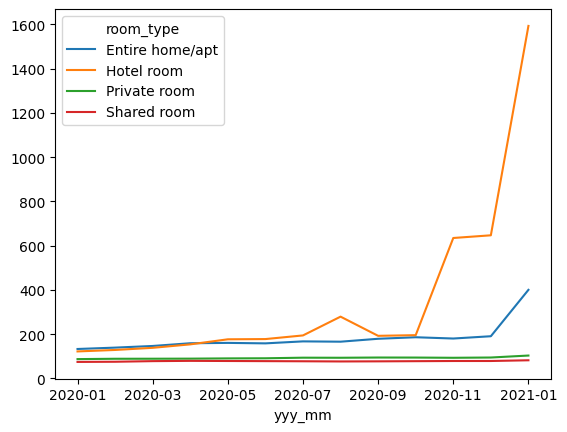

In [30]:
agrup_mes_type_room.plot()
plt.show()

<AxesSubplot:>

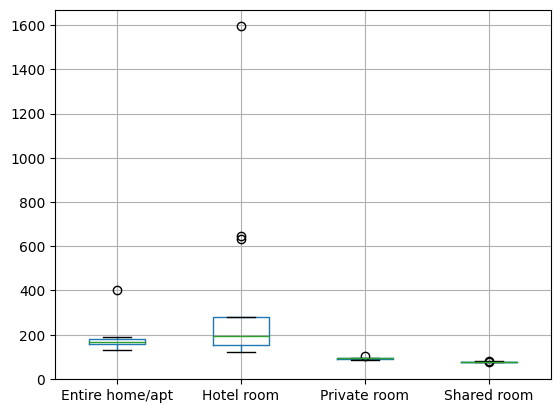

In [31]:
agrup_mes_type_room.boxplot()  

Surge de observar los gráficos que a comienzos del 2021 hay un crecimiento y caída muy fuertes fuera de escala. Para simplificar el análisis vamos a cerrar el periodo a 2020. Ese cambio abrupto para el 2021 hay que explicarlo con algún shock exógeno.

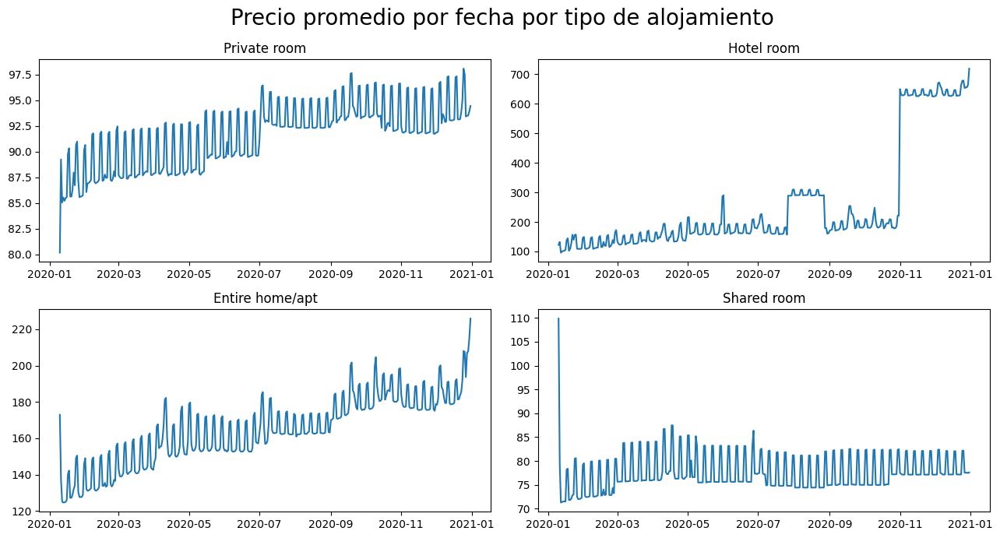

In [32]:
# Saco 2021

calendar2 = calendar[calendar['date'] <= '2020-12-31']

calendar_group_date_pr = calendar2[calendar2['room_type'] == 'Private room'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_er = calendar2[calendar2['room_type'] == 'Entire home/apt'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_hr = calendar2[calendar2['room_type'] == 'Hotel room'].groupby(['date']).agg(price_mean = ('price','mean'))
calendar_group_date_sr = calendar2[calendar2['room_type'] == 'Shared room'].groupby(['date']).agg(price_mean = ('price','mean'))

fig , axes = plt.subplots(2,2)
fig.set_size_inches([13,7])

axes[0,0].plot(calendar_group_date_pr)
axes[0,0].set_title('Private room')
axes[0,1].plot(calendar_group_date_hr)
axes[0,1].set_title('Hotel room')
axes[1,0].plot(calendar_group_date_er)
axes[1,0].set_title('Entire home/apt')
axes[1,1].plot(calendar_group_date_sr)
axes[1,1].set_title('Shared room')

plt.suptitle('Precio promedio por fecha por tipo de alojamiento',fontsize=20)
plt.tight_layout()
plt.show()

Como mencionamos antes, tenemos dos fuentes de variabilidad muy importantes, el Tipo de Alojamiento y la disponibilidad. A los efectos de mostrar una modelización de serie temporal, vamos a tomar el tipo de alojamiento 'Entire home/apt' abierto por disponibilidad. Cuando abrimos este tipo de alojamiento por disponibilidad, los datos están bastante balanceados, donde poco más del 50% no tiene disponibilidad inmediata.

In [33]:
Entire_home_apt = calendar2[calendar2['room_type'] == 'Entire home/apt']

In [34]:
Entire_home_apt['available'].value_counts()

f    2450065
t    2228257
Name: available, dtype: int64

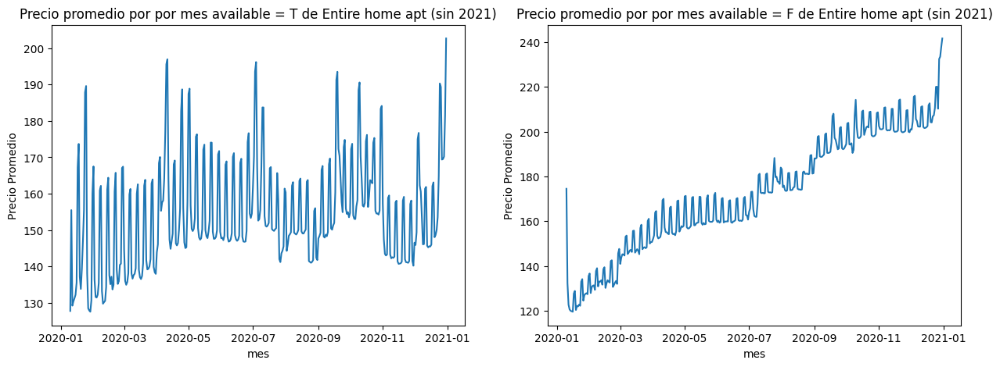

In [35]:
Entire_home_apt_group_date_t = Entire_home_apt[Entire_home_apt['available'] == 't'].groupby(['date']).agg(price_mean = ('price','mean'))
Entire_home_apt_group_date_f = Entire_home_apt[Entire_home_apt['available'] == 'f'].groupby(['date']).agg(price_mean = ('price','mean'))

fig , axes = plt.subplots(1,2)
fig.set_size_inches([15,5])

axes[0].plot(Entire_home_apt_group_date_t)
axes[0].set_title('Precio promedio por por mes available = T de Entire home apt (sin 2021)')
axes[0].set_xlabel('mes')
axes[0].set_ylabel('Precio Promedio')

axes[1].plot(Entire_home_apt_group_date_f)
axes[1].set_title('Precio promedio por por mes available = F de Entire home apt (sin 2021)')
axes[1].set_xlabel('mes')
axes[1].set_ylabel('Precio Promedio')

plt.show()

In [36]:
Entire_home_apt_group_date_t[['price_mean']].head(10)

,price_mean
date,
2020-01-10,127.792453
2020-01-11,155.504733
2020-01-12,129.255998
2020-01-13,130.438004
2020-01-14,131.291502
2020-01-15,132.241522
2020-01-16,135.576124
2020-01-17,167.188697
2020-01-18,173.688951


In [37]:
Entire_home_apt_group_date_f.head(10)

,price_mean
date,
2020-01-10,174.480182
2020-01-11,132.392847
2020-01-12,122.749422
2020-01-13,120.625016
2020-01-14,120.006991
2020-01-15,119.815835
2020-01-16,119.603877
2020-01-17,127.739703
2020-01-18,128.889106


Veamos a simple vista, antes del correspondiente test, como se ve la serie diferenciada.

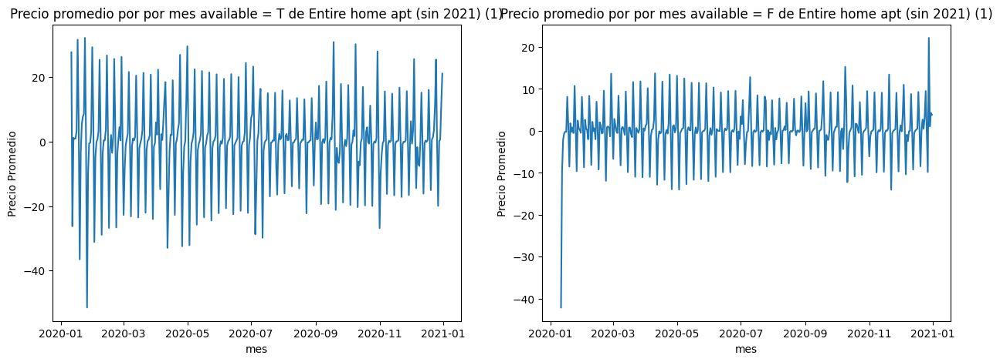

In [38]:
fig , axes = plt.subplots(1,2)
fig.set_size_inches([15,5])

axes[0].plot(Entire_home_apt_group_date_t.diff())
axes[0].set_title('Precio promedio por por mes available = T de Entire home apt (sin 2021) (1)')
axes[0].set_xlabel('mes')
axes[0].set_ylabel('Precio Promedio')

axes[1].plot(Entire_home_apt_group_date_f.diff())
axes[1].set_title('Precio promedio por por mes available = F de Entire home apt (sin 2021) (1)')
axes[1].set_xlabel('mes')
axes[1].set_ylabel('Precio Promedio')

plt.show()

El efecto "resorte" que se ve en los gráficos muestran un fuerte comportamiento estacional, vamos a limpiar este efecto con las herramientas que nos regala el paquete <i>statsmodels</i> de python. Una vez eliminado el componente estacional veamos cómo cambio la serie (integrada y diferenciada). 

In [39]:
seasonal = seasonal_decompose(Entire_home_apt_group_date_t['price_mean'], model='multiplicative', extrapolate_trend='freq')

deseasonalized = Entire_home_apt_group_date_t['price_mean'] / seasonal.seasonal
Entire_home_apt_group_date_t = deseasonalized.to_frame()
Entire_home_apt_group_date_t.columns = ['price_mean']

seasonal = seasonal_decompose(Entire_home_apt_group_date_f['price_mean'], model='multiplicative', extrapolate_trend='freq')
deseasonalized = Entire_home_apt_group_date_f['price_mean'] / seasonal.seasonal
Entire_home_apt_group_date_f = deseasonalized.to_frame()
Entire_home_apt_group_date_f.columns = ['price_mean']

Entire_home_apt_group_date_f = Entire_home_apt_group_date_f[1:]

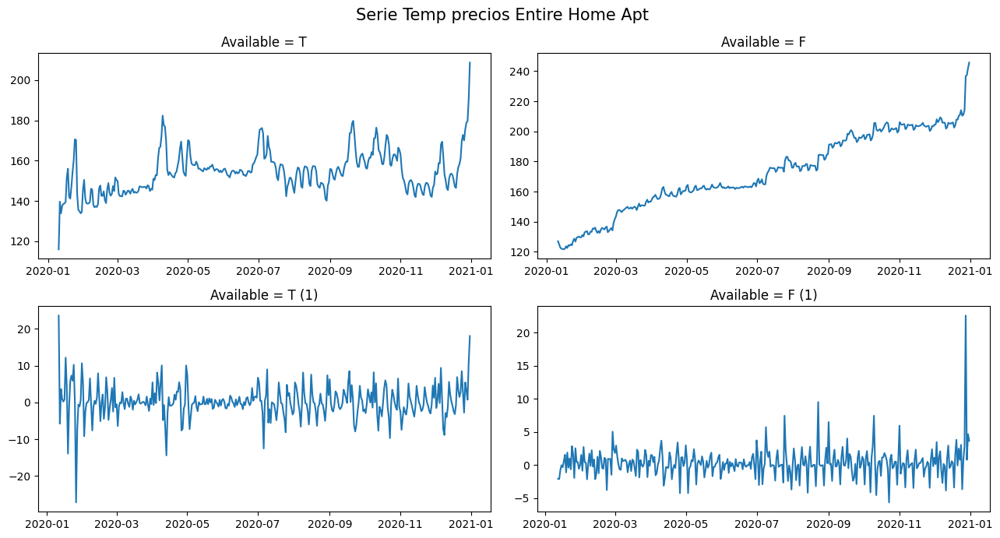

In [40]:
fig , axes = plt.subplots(2,2)
fig.set_size_inches([13,7])

axes[0,0].plot(Entire_home_apt_group_date_t)
axes[0,0].set_title('Available = T')
axes[0,1].plot(Entire_home_apt_group_date_f)
axes[0,1].set_title('Available = F')
axes[1,0].plot(Entire_home_apt_group_date_t.diff())
axes[1,0].set_title('Available = T (1)')
axes[1,1].plot(Entire_home_apt_group_date_f.diff())
axes[1,1].set_title('Available = F (1)')

plt.suptitle('Serie Temp precios Entire Home Apt',fontsize=15)
plt.tight_layout()
plt.show()

Una vez eliminado el componente estacional veamos como cambio la serie (integrada y diferenciada) 

Para acotar el análisis vamos a centrarnos en los precios de los alojamientos Entire Home Apt que están disponibles. Mediante el test de <i>Dickey Fuller</i> comprobamos si la serie original está integrada y, en caso que lo esté, corroborar si la primera diferencia ya nos da una serie estacionaria. Bajo la hipótesis nula de este test, la serie tiene tendencia. Si rechazamos la hipótesis nula (con un <i>p-value</i> menor a 0.05) verificaremos que la serie es estacionaria.  

In [41]:
Entire_home_apt_group_date_t_diff = Entire_home_apt_group_date_t.diff()
Entire_home_apt_group_date_f_diff = Entire_home_apt_group_date_f.diff()
Entire_home_apt_group_date_t_diff.dropna(inplace=True)
Entire_home_apt_group_date_f_diff.dropna(inplace=True)

Vemos efectivamente que la serie tiene tendencia... 

In [42]:
print('t-statics:',adfuller(Entire_home_apt_group_date_t['price_mean'])[0],' p-value:',adfuller(Entire_home_apt_group_date_t['price_mean'])[1])

t-statics: -1.5621000365393691  p-value: 0.5025986883410896


... pero la primer diferencia es estacionaria.

In [43]:
print('t-statics:',adfuller(Entire_home_apt_group_date_t_diff['price_mean'])[0],' p-value:',adfuller(Entire_home_apt_group_date_t_diff['price_mean'])[1])

t-statics: -4.542114891027021  p-value: 0.00016491096585130474


Para identificar la serie graficamos las funciones de autocorrelación (ACF) y autocorrelación parcial (PACF). Con estos gráficos vemos los rezagos significativos para estimar la ecuación ARMA(p,q) de la serie.

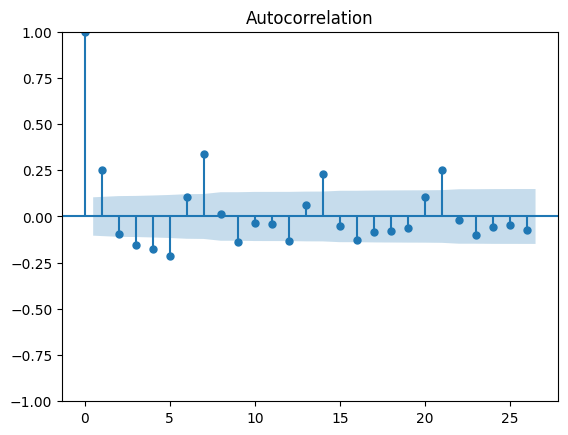

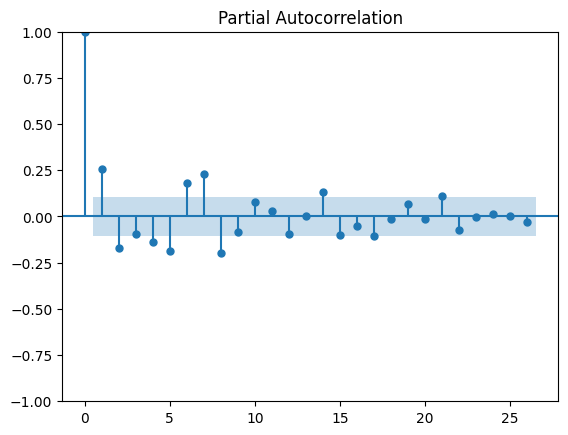

In [44]:
plot_acf(Entire_home_apt_group_date_t_diff);
plot_pacf(Entire_home_apt_group_date_t_diff);
plt.rcParams.figsize= (12,5) 

Para estimar la ecuación ARMA(p,q) se prueban los rezagos significativos de las ACF y PACF como coeficientes AR(p) y MA(q). La literatura indica que una caída sinusoidal en ambos gráficos indican un modelo ARMA(p,q) siendo p los rezagos significativos del PACF y q del ACF. Si el PACF tiene caída sinusoidal y y ACF rezagos significativos hasta el orden q, el modelo será un MA(q) y, si la caída sinusoidal se da en el ACF y el PACF tiene p rezagos significativos el modelos será AR(p). En nuestro caso (con un poco de imaginación) se podría interpretar una caída sinusoidal tanto en el ACF como PACF. Por otro lado, tiene aleatoriamente algunos rezagos levemente significativos. Luego de realizar un par de pruebas buscando el modelo que ajuste bien los parámetros y sea lo más parsimonioso posible, la ecuación ARMA(7,1) es la que mejor ajusta.
    <br>
    Ambos coeficientes son significativos y menores a 1, comparado a otros modelos estimados por los criterios de información AIC y BIC el modelo era el mejor. 

In [45]:
model = ARIMA(Entire_home_apt_group_date_t_diff,order=([7],0,1))
model = model.fit()
print(model.summary())

                               SARIMAX Results                                
Dep. Variable:             price_mean   No. Observations:                  356
Model:               ARIMA([7], 0, 1)   Log Likelihood                -985.799
Date:                Mon, 29 Aug 2022   AIC                           1979.597
Time:                        02:16:53   BIC                           1995.097
Sample:                    01-11-2020   HQIC                          1985.763
                         - 12-31-2020                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4508      0.416      1.084      0.278      -0.364       1.266
ar.L7          0.4180      0.033     12.702      0.000       0.353       0.482
ma.L1          0.3270      0.037      8.891      0.0

Abrimos el diagnóstico del modelo y el mismo no es muy alentador. No queda claro que los residuos sigan una distribución normal.

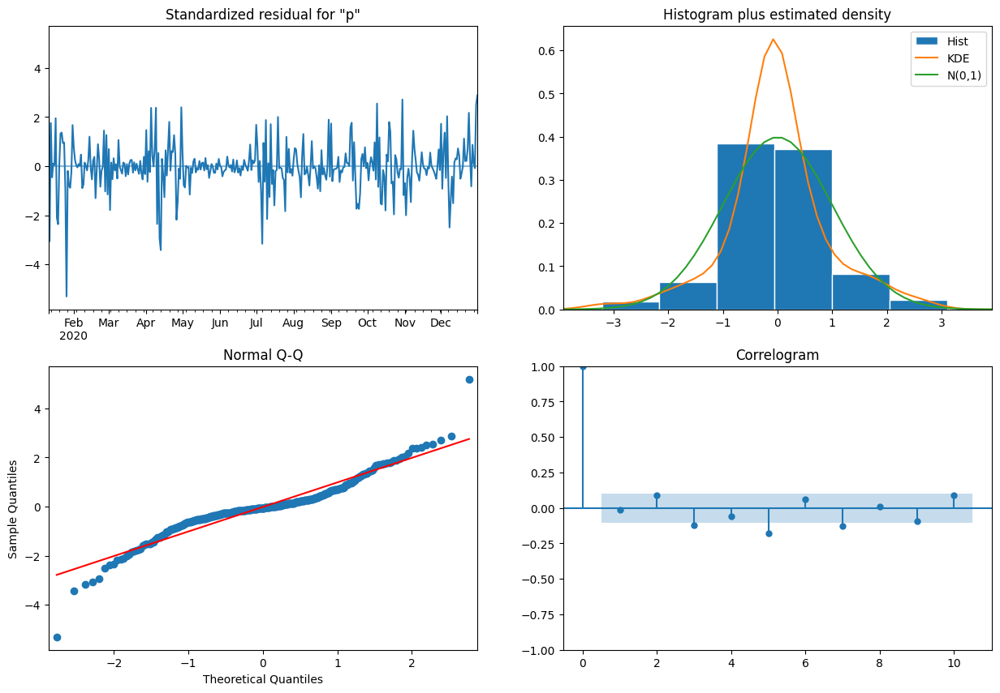

In [46]:
model.plot_diagnostics(figsize = (15, 10))
plt.show()

En general los modelos ARMA(p,q) y sus derivados no son grandes predictores dado que tienen memoria corta. Más bien son buenos para hacer inferencia sobre la serie. Sin embargo, vamos a poner un poco a prueba el modelo. Vamos a hacer una predicción en el periodo de tiempo analizado y ver como son los resultados respecto a los valores reales.

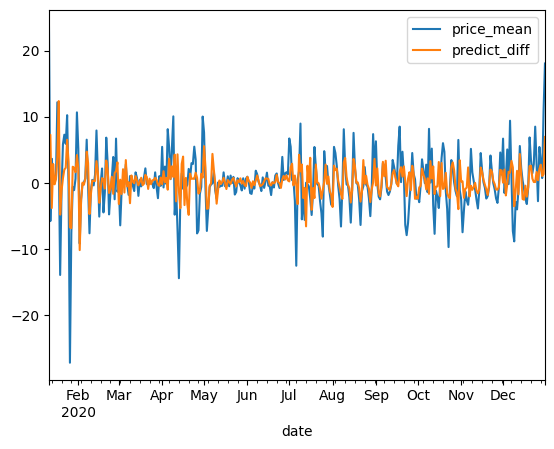

In [47]:
pred_insample = model.get_prediction(start = Entire_home_apt_group_date_t_diff.index.min() , end = Entire_home_apt_group_date_t_diff.index.max())
pred_insample = pd.Series(pred_insample.predicted_mean).to_frame()
pred_insample.columns = ['predict_diff']
Entire_home_apt_group_date_t_diff = Entire_home_apt_group_date_t_diff.merge(pred_insample,how='left',left_index=True,right_index=True)
Entire_home_apt_group_date_t_diff.plot()
plt.show()

Integramos los valores predichos tomando como valor inicial que perdimos al diferenciar la serie y graficamos con los valores reales.

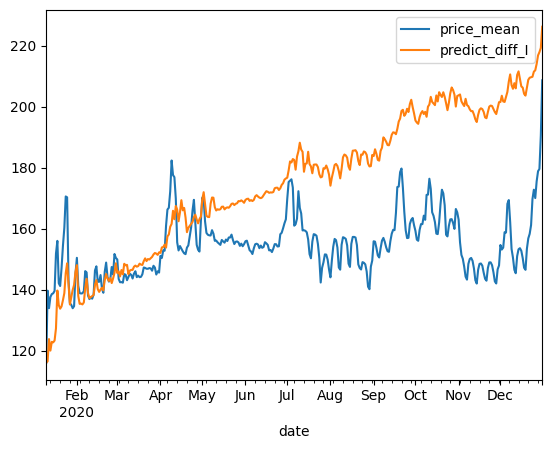

In [48]:
Entire_home_apt_group_date_t = Entire_home_apt_group_date_t.merge(Entire_home_apt_group_date_t_diff,how='left',left_index=True,right_index=True)
Entire_home_apt_group_date_t.columns = ['price_mean','price_mean_diff','predict_diff']
Entire_home_apt_group_date_t['predict_diff_I'] = Entire_home_apt_group_date_t['predict_diff']
Entire_home_apt_group_date_t['predict_diff_I'][0] = Entire_home_apt_group_date_t['price_mean'][0]
Entire_home_apt_group_date_t['predict_diff_I'] = Entire_home_apt_group_date_t['predict_diff_I'].cumsum()
Entire_home_apt_group_date_t[['price_mean','predict_diff_I']].plot()
plt.show()

La predicción no es muy buena, sobre todo desde el mes de Marzo. Esto se puede deber a varios factores: mala identificación del modelo, el proceso no cumple con los supuestos de la modelización ARMA, etc. Vamos a adentrarnos de forma puntual en los supuestos referidos a la varianza. La misma debería ser constante y aleatoria. En caso que no fuera así, diremos que potencialmente puede tener estructura. Al observar detenidamente el gráfico de la serie diferenciada se observa que en distintos periodos de tiempo tiene varianza muy distinta. Se ve una varianza alta y decreciente a principio de año, muy baja desde marzo, luego alta de nuevo, en los meses de mayo a julio muy baja (cuando comienza la temporada más alta) y finalizado julio hasta diciembre sí se ve cierta estabilidad. Estos cambios en la varianza afectan directamente a la modelización ARMA(p,q). Tanto es así que surge de la literatura la modelización de la varianza conocida como GARCH (Generalized AutoRegressive Conditional Heteroskedasticity). Estos modelos de alguna manera capturan la estructura de la varianza logrando, entre otras cosas, mejores predicciones.

<AxesSubplot:xlabel='date'>

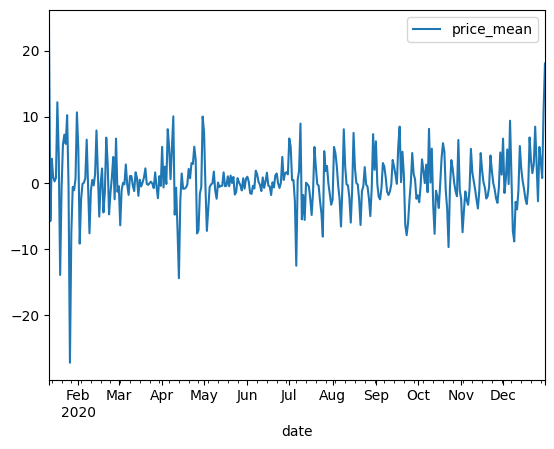

In [49]:
Entire_home_apt_group_date_t_diff[['price_mean']].plot()

Con el test Ljung-Box verificamos la aleatoriedad de los residuos, con un p- value menor a 0.05 testeamos que no lo son.

In [50]:
# Los rediduos del modelo son aleatorios?, p- value menor a 0.05 no lo son
arima_resid = model.resid
white_noise_arima = acorr_ljungbox(arima_resid, lags = [10], return_df=True)
white_noise_arima

,lb_stat,lb_pvalue
10,34.219668,0.00017


Los residuos no son aleatorios pero no alcanza con probar esto para afirmar heterocedasticidad. Realizamos el test Arch, el <i>p-value</i> menor a 0.05 justifica un modelo GARCH.

In [51]:
test3 = {'Estadístico': het_arch(arima_resid, ddof = 4)[0], 'Pvalue': het_arch(arima_resid, ddof = 4)[1]}
test3 = pd.DataFrame(data=test3,index=['values'])
test3

,Estadístico,Pvalue
values,24.140318,0.007237


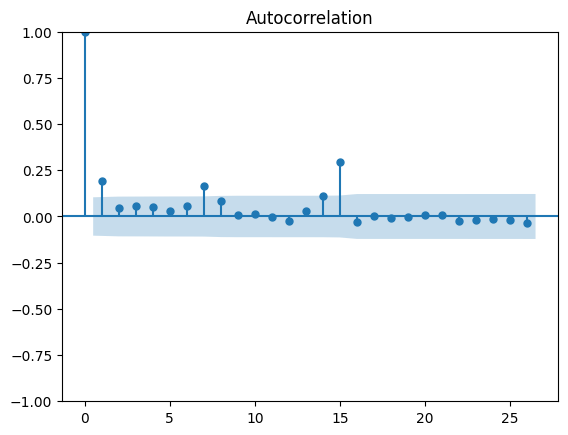

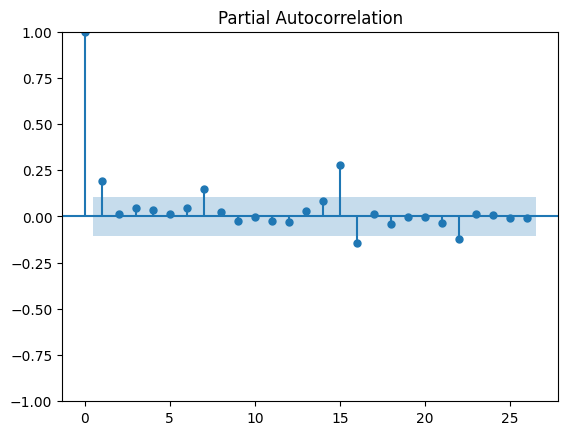

In [52]:
plot_acf(arima_resid**2);
plot_pacf(arima_resid**2);
plt.rcParams.figsize= (12,5) 

El primer rezago en cada gráfico se ve levemente significativo, luego el 7 y el 15, mostrando que todavía queda algún componente estacional más allá de la desestacionalización realizada. Con esto cerramos la parte de series temporales, sin embargo los datos dan para continuar exhaustivamente explorando qué pasa con los precios a lo largo del tiempo.

#### Un poco de NLP

El objetivo de esta sección es mostrar algún manejo básico de los datos de texto. Esta sección se puede complementar con el archivo de R donde cree una red de palabras como método de visualización, basando el tamaño de cada nodo en la importancia de la palabra y el link que une cada palabra con otra la intensidad de la relación entre ellas.

In [53]:
comentarios_completo = pd.read_csv('dataset_nuevo/reviews.csv.gz',compression='gzip')
#comentarios_completo["comments"] = comentarios_completo["comments"].str.lower() # paso todo a minuscula
comentarios_completo["comments"] = comentarios_completo["comments"].str.replace(u"\u00A0", " " ,regex=True) 
comentarios_completo["comments"] = comentarios_completo["comments"].str.replace("\xc2\xa0", " " ,regex=True)
comentarios_completo["comments"] = comentarios_completo["comments"].str.replace("\n", " " ,regex=True)
comentarios_completo["comments"] = comentarios_completo["comments"].str.replace("\t", " " ,regex=True)
comentarios_completo["comments"] = comentarios_completo["comments"].str.replace("\r", " " ,regex=True)
comentarios_completo['comments'] = comentarios_completo['comments'].str.replace(r'\b\w{1,3}\b', "" ,regex=True)

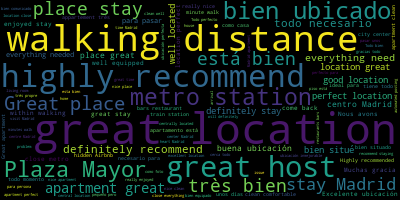

In [55]:
palabras = ''.join([str(item) for item in comentarios_completo['comments']])
wordcloud.generate(palabras)
wordcloud.to_image()

Separemos por tipo de alojamiento.

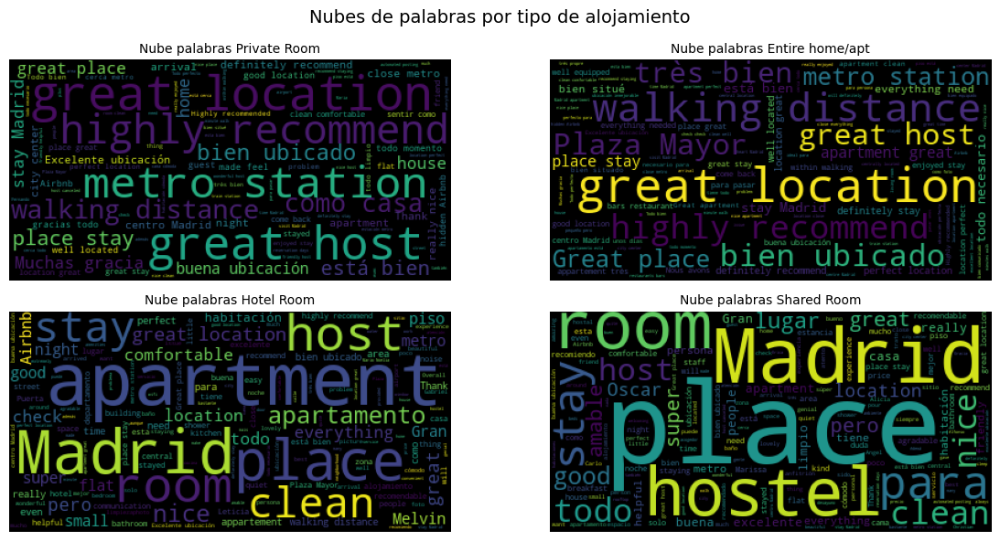

In [56]:
room_type_to_comentarios = listings[['id','room_type']]
comentarios_completo = comentarios_completo.merge(room_type_to_comentarios,how='left',left_on='listing_id',right_on='id')
comentarios_completo = comentarios_completo[['listing_id','id_x','date','reviewer_id','reviewer_name','comments','room_type']]
comentarios_completo.columns = ['listing_id','id','date','reviewer_id','reviewer_name','comments','room_type']

comentarios_Private_room = comentarios_completo[comentarios_completo['room_type'] == 'Private room']
comentarios_Entire_home_apt = comentarios_completo[comentarios_completo['room_type'] == 'Entire home/apt']
comentarios_Hotel_room = comentarios_completo[comentarios_completo['room_type'] ==  'Hotel room']
comentarios_Shared_room = comentarios_completo[comentarios_completo['room_type'] == 'Shared room']

palabras_Private_room = ''.join([str(item) for item in comentarios_Private_room['comments']])
palabras_Entire_home_apt = ''.join([str(item) for item in comentarios_Entire_home_apt['comments']])
palabras_Hotel_room = ''.join([str(item) for item in comentarios_Hotel_room['comments']])
palabras_Shared_room = ''.join([str(item) for item in comentarios_Shared_room['comments']])

Private_room_wordcloud = wordcloud.generate(palabras_Private_room)
Entire_home_apt_wordcloud = wordcloud.generate(palabras_Entire_home_apt)
Hotel_room_wordcloud = wordcloud.generate(palabras_Hotel_room)
Shared_room_wordcloud = wordcloud.generate(palabras_Shared_room)


from wordcloud import WordCloud
Private_room_wordcloud = WordCloud().generate(palabras_Private_room)
Entire_home_apt_wordcloud = WordCloud().generate(palabras_Entire_home_apt)
Hotel_room_wordcloud = WordCloud().generate(palabras_Hotel_room)
Shared_room_wordcloud = WordCloud().generate(palabras_Shared_room)

fig, ((ax,ax1),(ax2,ax3)) = plt.subplots (2,2)
fig.set_size_inches([12,6])

ax.imshow(Private_room_wordcloud)
ax.axis('off')
ax.set_title('Nube palabras Private Room', fontsize = 10)

ax1.imshow(Entire_home_apt_wordcloud)
ax1.axis('off')
ax1.set_title('Nube palabras Entire home/apt', fontsize = 10)

ax2.imshow(Hotel_room_wordcloud)
ax2.axis('off')
ax2.set_title('Nube palabras Hotel Room', fontsize = 10)

ax3.imshow(Shared_room_wordcloud)
ax3.axis('off')
ax3.set_title('Nube palabras Shared Room', fontsize = 10)

plt.suptitle('Nubes de palabras por tipo de alojamiento',fontsize=14)
plt.tight_layout()
plt.show()

In [57]:
comentarios_completo["comments"] = comentarios_completo["comments"].str.lower() # paso todo a minuscula
comentarios_completo['tokens'] = comentarios_completo["comments"].str.split() # tokenizo
comentarios_completo['q_palabras'] = comentarios_completo['tokens'].astype('str').str.split().str.len()

Miremos un poco la cantidad de palabras por comentario. 

Comentarios con menos de 100 palabras...

In [58]:
comentarios_completo['q_palabras'].describe()

count    812726.000000
mean         24.585198
std          24.376495
min           1.000000
25%           9.000000
50%          18.000000
75%          32.000000
max         622.000000
Name: q_palabras, dtype: float64

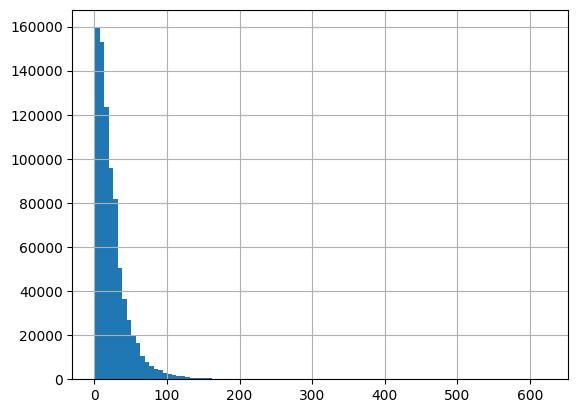

In [59]:
comentarios_completo['q_palabras'].hist(bins=100)
plt.show()

Comentarios con menos de 100 palabras...

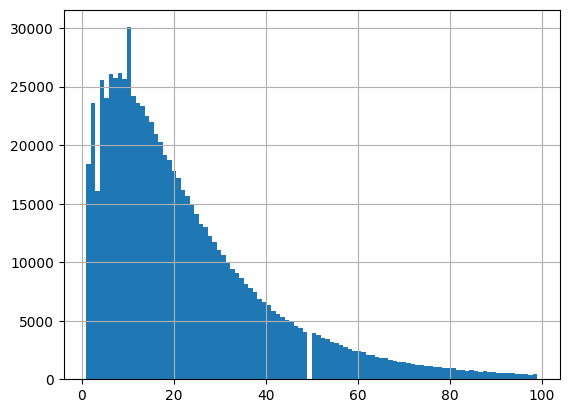

In [60]:
comentarios_completo[comentarios_completo['q_palabras']<100]['q_palabras'].hist(bins=100)
plt.show()

In [61]:
comentarios_completo[comentarios_completo['q_palabras']<100]['q_palabras'].describe()

count    799251.000000
mean         22.649782
std          18.470304
min           1.000000
25%           9.000000
50%          18.000000
75%          31.000000
max          99.000000
Name: q_palabras, dtype: float64

Largo comentarios por tipo de alojamiento

In [62]:
comentarios_completo.groupby(['room_type']).agg(largo_comet_prom = ('q_palabras','mean'))

,largo_comet_prom
room_type,
Entire home/apt,25.368059
Hotel room,24.243559
Private room,22.470090
Shared room,18.321839


In [ ]:
# from collections import Counter
# palabras = []
# for token in comentarios_completo['tokens']:
#     palabras = palabras + [token]
#     #palabras = palabras.append(token)
# palabras = Counter(palabras).most_common()
# # palabras = Counter(palabras).most_common(10) #si quiero las x palabras mas repetidas
# df_palabras = pd.DataFrame(palabras, columns = ['palabra', 'repet'])
# df_palabras['cum_percent'] = 100*(df_palabras['repet'].cumsum() / df_palabras['repet'].sum())